# Deep Learning from Audio Signals

### Feature engineering: Create FFT, STFT and MFCC

Rajesh Siraskar | 02-May-2021

#### Features
- Waveform
- FFT -> spectrum
- STFT -> short time FT - spectrogram
- MFCCs (Mel-frequency cepstral coefficients -> a nonlinear "spectrum-of-a-spectrum")


In [1]:
import warnings
import os
from pathlib import Path

import librosa, librosa.display
from matplotlib import pyplot as plt
import IPython.display as ipd
import numpy as np

%matplotlib inline

warnings.filterwarnings("ignore")

In [8]:
PATH = 'D:/ML/DSP/audio_files/' 

In [9]:
# Analyze personal .wav file
afile  = os.path.join('..', PATH, 'HelloAudioWorld_2.wav')
m1file = os.path.join('..', PATH, 'badass.wav') # Beats
# m2file = os.path.join('..', PATH, 'Canary.wav')  # Bird-Canary
# m3file = os.path.join('..', PATH, 'MeadowLark.wav')  # Bird-MeadowLark
m4file = os.path.join('..', PATH, 'happyrock.wav')  # Electronica rock      
m5file = os.path.join('..', PATH, 'jazzyfrenchy.wav')  # Clapping/feet-tapping
m6file = os.path.join('..', PATH, 'creativeminds.wav')  # Slow start, strings

In [11]:
ipd.Audio(m5file)

In [12]:
# Analyze audio file
waveform, sample_rate  = librosa.load(m5file, sr=22050)

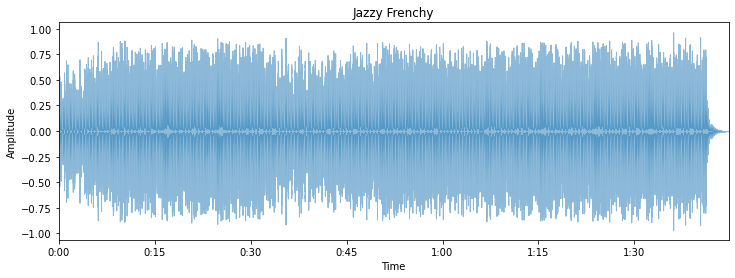

In [13]:
# Visualize the waveform
plt.figure(figsize=(12,4))
librosa.display.waveplot(waveform, alpha=0.5)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Jazzy Frenchy')
plt.show()

### FFT Spectrum

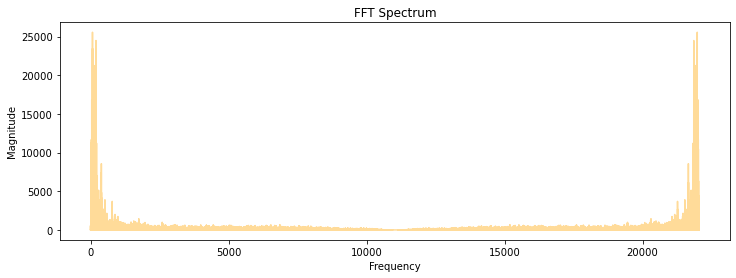

In [14]:
fft = np.fft.fft(waveform)

# Get magnitudes of the complex number arrays
fft_magnitude = np.abs(fft)
fft_frequency = np.linspace(0, sample_rate, len(fft_magnitude))

# Visualize the FFT 
plt.figure(figsize=(12,4))
plt.plot(fft_frequency, fft_magnitude, color='orange', alpha=0.4)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('FFT Spectrum')
plt.show()

**Aliasing around NF**
- When plotted - it shows a reflection around Nyquist Frequency = SR/2.
- Reflection = aliasing
- Consider on half the array

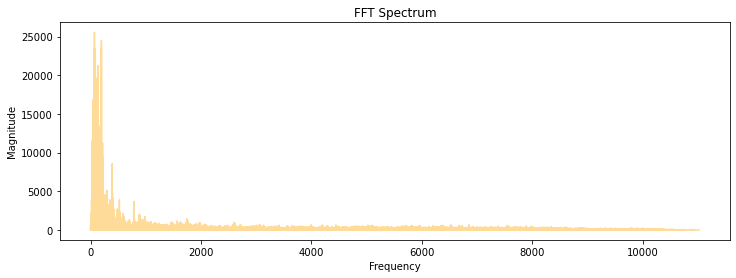

In [15]:
fft_magnitude = fft_magnitude[:int(len(fft_magnitude)/2)]
fft_frequency = fft_frequency[:int(len(fft_frequency)/2)]
# Visualize the FFT 
plt.figure(figsize=(12,4))
plt.plot(fft_frequency, fft_magnitude, color='orange', alpha=0.4)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('FFT Spectrum')
plt.show()

 ### STFT Spectrogram
 
 - Short Time Fourier Transform 
 - 1st plot - Normal scale spectrogram
 - 2nd plot - We perceive sound **logarithmically**, so next cell we plot spectrogram in Log scale

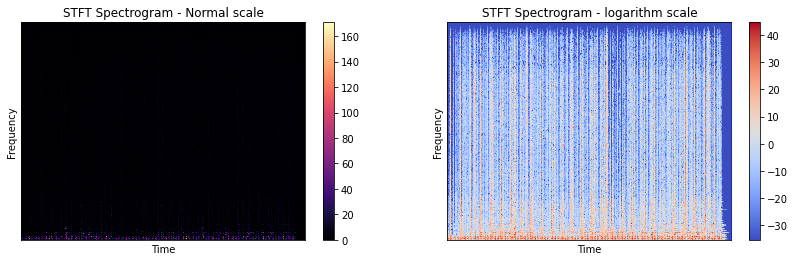

In [18]:
n_fft = 2048
hop_length = 512

stft = librosa.core.stft(waveform, hop_length=hop_length, n_fft=n_fft)

spectrogram = np.abs(stft) # Normal complex number magnitude

# Visualize 2 spectrograms side-by-side
plt.figure(figsize=(14, 4))

#### Normal complex number magnitude
plt.subplot(1, 2, 1) # 1 rows by 2 cols, 1st plot
librosa.display.specshow(spectrogram, sr=sample_rate, hop_length=hop_length)
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()
plt.title('STFT Spectrogram - Normal scale')

#### Log scale of complex number magnitude
#### Normal complex number magnitude
plt.subplot(1, 2, 2) # 1 rows by 2 cols, 1st plot
log_spectrogram = librosa.amplitude_to_db(spectrogram) # Log scale
librosa.display.specshow(log_spectrogram, sr=sample_rate, hop_length=hop_length)
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.colorbar()
plt.title('STFT Spectrogram - logarithm scale')

plt.show()

### MFCC Spectrogram
 
- Mel-frequency Cepstral coefficients 
- 1st step of MFCC is the STFT itself, therefore frame length and hop length needed here too
- Spectrgram will show bands a NUMBER of bands = no of coeff. requested

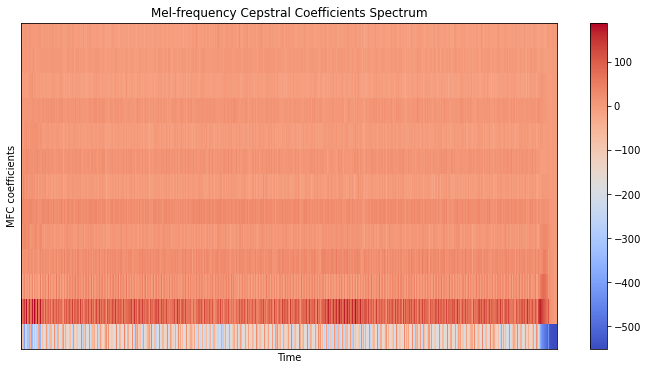

In [19]:
MFCC = librosa.feature.mfcc(waveform, n_fft=n_fft, hop_length=hop_length, n_mfcc=13)

plt.figure(figsize=(12,6))
librosa.display.specshow(MFCC, sr=sample_rate, hop_length=hop_length)
plt.xlabel('Time')
plt.ylabel('MFC coefficients')
plt.title('Mel-frequency Cepstral Coefficients Spectrum')
plt.colorbar()
plt.show()